# 3DMoCap

USE UNCOMMENTED CODES!!!

## Python version check

In [6]:
import sys
print(sys.version)

3.6.10 |Anaconda, Inc.| (default, May  8 2020, 02:54:21) 
[GCC 7.3.0]


## Import necessary packages

In [2]:
import os
import subprocess
import numpy as np
from pathlib import Path
from IPython.display import HTML
from video2bvh.utils import vis, camera
from video2bvh.bvh_skeleton import h36m_skeleton

%matplotlib notebook

## Choose data folder

update for each video

In [3]:
video_folder = 'mocap-data/'
video = 'test_front.mp4' ## Input video
video_name, video_format = video.split('.')
video_path = os.path.join(video_folder,video)
depth_path = 'depth.txt' ## The depth file you got from OpenMMD
out_video_path = os.path.join(video_folder, 'out_'+video) ## doesn't matter
out_3djoints_path = os.path.join(video_folder, 'joints3d') ## 3d joints with hip= (0,0,0)
output_name = 'test_front_50fps_s1.bvh'  ## The .bvh file name you want

mocap-data/test_front.mp4 test_front mp4


## Preprocessing

Process original video into 50 FPS mp4 format.

In [8]:
new_video = video_name + '_50fps.mp4'
new_video_path = os.path.join(video_folder, new_video)
preprocess = subprocess.Popen(
    args=[
        'ffmpeg',
        '-i', video_path,
        '-filter:v', "minterpolate='fps=50'",
        '-crf', '0',
        new_video_path
    ],
    cwd='.'
)
video = new_video
video_path = new_video_path

## detectron2 -- 2D prediction

In [32]:
detectron = subprocess.Popen(
    args=[
        'python',
        'video-pose-3d/inference/infer_video_d2.py',
        '--cfg', 'COCO-Keypoints/keypoint_rcnn_R_101_FPN_3x.yaml',
        '--output-dir', video_folder,
        '--image-ext', 'mp4',
        video_path
    ],
    cwd='.'
)

## Prepare data for VideoPose3D

In [41]:
pre3d = subprocess.Popen(
    args=[
        'python',
        'prepare_data_2d_custom.py',
        '-i', '../../'+video_folder,
        '-o', 'temp'
    ],
    cwd='video-pose-3d/data'
)

## VideoPose3D -- 3D prediction

In [9]:

vp3d = subprocess.Popen(
    args=[
        'python', 
        'run.py',
        '-d', 'custom',
        '-k', 'temp',
        '-arc', '3,3,3,3,3',
        '-c', 'checkpoint',
        '--evaluate', 'pretrained_h36m_detectron_coco.bin',
        '--render', 
        '--viz-subject', video,
        '--viz-action', 'custom',
        '--viz-camera', '0',
        '--viz-video', '../'+video_path,
        '--viz-output', '../'+out_video_path,
        '--viz-size', '6',
        '--viz-export', '../'+out_3djoints_path
    ],
    cwd='video-pose-3d'
)

## Visualization

In [4]:
# Camera params
cam_data = camera.load_camera_params('video2bvh/cameras.h5')
subject = 'S1'
cam_id = '55011271'
cam_params = cam_data[subject][cam_id]
R = cam_params['R']
T = 0
azimuth = cam_params['azimuth']

/home/arcadia/Documents/ML/MoCap/3DMoCap/video2bvh/utils/camera.py:11: H5pyDeprecationWarning: The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.
  with h5py.File(cam_file) as f:


scaling: 527.6213033779773:1
-0.9113315529375048
-0.904792016833081
-0.9006232630850382
-0.8941443072742247
-0.8952273960713482
-0.8829166753144719
-0.8794504818495873
-0.8704995128753389
-0.8585205006193167
-0.84123168709079
-0.8115654505515898
-0.7903510158000662
-0.7626692791682393
-0.7372213299362318
-0.7137919203237973
-0.6898034671529366
-0.6766456127107083
-0.6548475296951808
-0.6374513208406108
-0.6142194084287691
-0.5887430683521838
-0.573909403154163
-0.5442226911909497
-0.525483788532446
-0.505276669399668
-0.4647307294846178
-0.4502435529953219
-0.4202602516423741
-0.38675664794928266
-0.36379449212221493
-0.33482896686833397
-0.3223362327405025
-0.2957468039182761
-0.27756288828541664
-0.2616022625451574
-0.23151121871327263
-0.21268629206790857
-0.1887429126833765
-0.16634526326619625
-0.14491207429591102
-0.10804274068339981
-0.09727201069871927
-0.0708553078034524
-0.05678500085623395
-0.04205726674932653
-0.01731258252834189
-0.010590833753147844
-0.004538917790088137


Animation size has reached 20984021 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


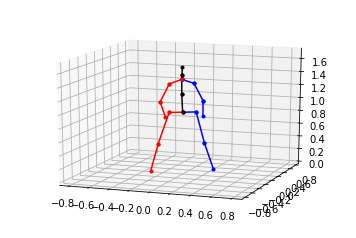

In [11]:
# Step 1: Read the 3d joints with hip = (0,0,0)
pose3d_fix = np.load(out_3djoints_path+'.npy')
pose3d_world = camera.camera2world(pose=pose3d_fix, R=R, T=T)

# Step 2: Get the depth info of hip got by OpenMMD
depth = []
with open(depth_path, 'r') as f:
    temp = f.readline()
    while temp:
        de = temp.split(", ")
        dee = de[1].split("\n")[0]
        depth.append(dee)
        temp = f.readline()
f.close()

# Step 3：Get the x, y position of hip generated by 2D prediction
pose2d_npz_path = 'video-pose-3d/data/data_2d_custom_temp.npz'
pose2d_dict = np.load(pose2d_npz_path, allow_pickle=True)['positions_2d']
pose2d = pose2d_dict.item()[video]['custom'][0]
pose2d_hips = (pose2d[:,11,:] + pose2d[:,12,:]) / 2.0

# Step 4: Scale the data to get final hip position
depth = np.array(depth)
depth = depth.astype(np.float)
mid = np.max(depth)-np.min(depth)
small = np.max(pose3d_world[0,:,2])-np.min(pose3d_world[0,:,2])
large = np.max(pose2d[0,:,1])-np.min(pose2d[0,:,1])
scale = large / small
scale2 = large/mid
print(f'scaling: {scale}:1')
hip_moves = (pose2d_hips - pose2d_hips[0]) / scale

# Step 5: Add x,y into hip
all_moves = []
for i in range(len(hip_moves)):
    all_moves.append([hip_moves[i,:]]*17)
all_moves = np.array(all_moves)

pose3d_world[:,:,0] += all_moves[:,:,0]
pose3d_world[:,:,2] += all_moves[:,:,1]\
# test lower bound
for i in range(pose3d_world.shape[0]):
    low_point = np.min(pose3d_world[i,:,2])
    if low_point < 0.0:
        pose3d_world[i,:,2] -= low_point
        
# Step 6: Add depth info
for i in range(0,len(depth)):
    pose3d_world[i][0][1] = depth[i]/scale2
    
# Step 7: visualize result
h36m_skel = h36m_skeleton.H36mSkeleton()
ani = vis.vis_3d_keypoints_sequence(
    keypoints_sequence=pose3d_world[:],
    skeleton=h36m_skel,
    azimuth=azimuth,
    fps=60,
    output_file=video_folder+'result.gif'
)
HTML(ani.to_jshtml())

## Convert to BVH

In [13]:
bvh_path = video_folder + Output_Name
h36m_skel = h36m_skeleton.H36mSkeleton()
_ = h36m_skel.poses2bvh(pose3d_world, output_file=bvh_path)

The result is saved in the same folder.